# Wizeline challenge

## 1st Dataset: 

In the file training_data.csv, you will find the training data set of 800 samples. Each sample has
20 features, named [feature_0, feature_1, … , feature_19].
As an AI engineer, you will be in charge of training a model to predict a target variable that you
will find in the target column of the training_data file.

In [ ]:
!python -m venv venv

In [2]:
%%writefile ../requirements.txt

pandas
seaborn
matplotlib
scikit-learn
tensorflow
setuptools
streamlit
joblib

Overwriting ../requirements.txt


In [ ]:
!pip install -r requirements.txt

In [3]:
import pandas as pd

df = pd.read_csv("./training_data.csv")
df.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,target
0,432.475954,289.373016,481.315600,358.755566,802.659004,176.761177,72.648102,720.969179,36.327684,83.768878,...,4.385848,516.789458,19.624422,13.162440,42.351948,35.920392,20.755984,13.814300,384.497136,14.364922
1,517.596250,330.448341,585.920055,22.684031,169.813240,335.601640,284.451476,748.101047,73.701438,358.147215,...,5.563334,2.960064,20.721878,17.740184,1.726915,167.576065,75.492679,2.480979,303.710869,19.984801
2,189.439350,553.888820,165.833790,202.465927,176.695586,321.155049,407.278389,161.245668,282.269025,221.570899,...,4.536947,581.823741,101.695639,0.653592,486.859084,117.491548,6.420465,20.713314,22.651537,12.944351
3,237.307878,195.894881,416.752252,468.729031,611.693517,301.411711,241.880655,49.597044,122.396821,13.828319,...,5.518968,45.014729,196.350455,47.638515,411.414213,67.142022,115.630943,8.927957,388.240433,14.792440
4,602.845256,16.103208,221.759979,345.765574,558.588369,276.704241,408.069566,19.390813,138.769765,146.662193,...,2.136214,133.590430,197.634584,26.278027,111.127557,172.181136,85.869642,30.537857,625.931837,11.802634


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 21 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   feature_0   800 non-null    float64
 1   feature_1   800 non-null    float64
 2   feature_2   800 non-null    float64
 3   feature_3   800 non-null    float64
 4   feature_4   800 non-null    float64
 5   feature_5   800 non-null    float64
 6   feature_6   800 non-null    float64
 7   feature_7   800 non-null    float64
 8   feature_8   800 non-null    float64
 9   feature_9   800 non-null    float64
 10  feature_10  800 non-null    float64
 11  feature_11  800 non-null    float64
 12  feature_12  800 non-null    float64
 13  feature_13  800 non-null    float64
 14  feature_14  800 non-null    float64
 15  feature_15  800 non-null    float64
 16  feature_16  800 non-null    float64
 17  feature_17  800 non-null    float64
 18  feature_18  800 non-null    float64
 19  feature_19  800 non-null    f

<Axes: >

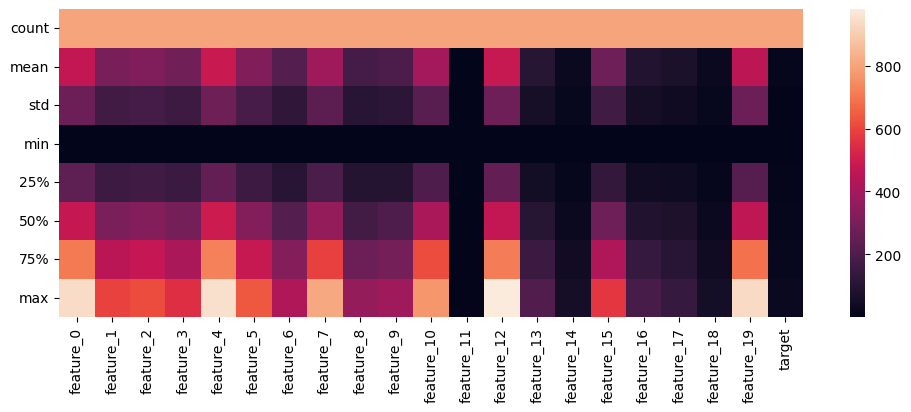

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.describe(), figure=plt.figure(figsize=(12, 4)))

<Axes: >

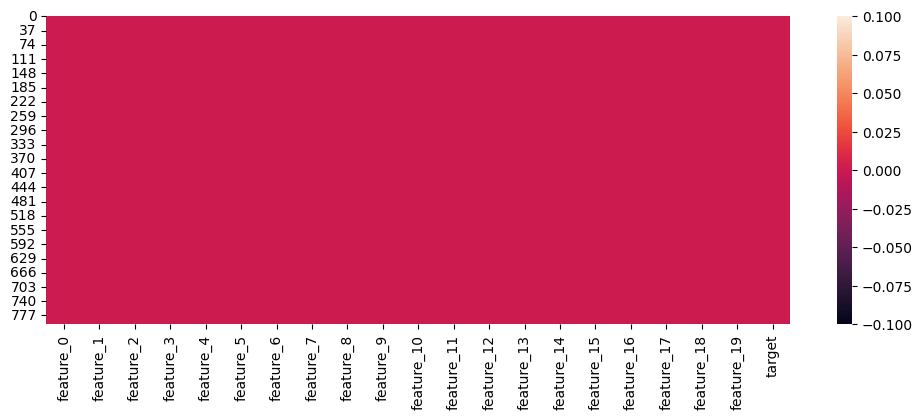

In [6]:
sns.heatmap( df.isnull(), figure=plt.figure(figsize=(12, 4))  )

<Axes: >

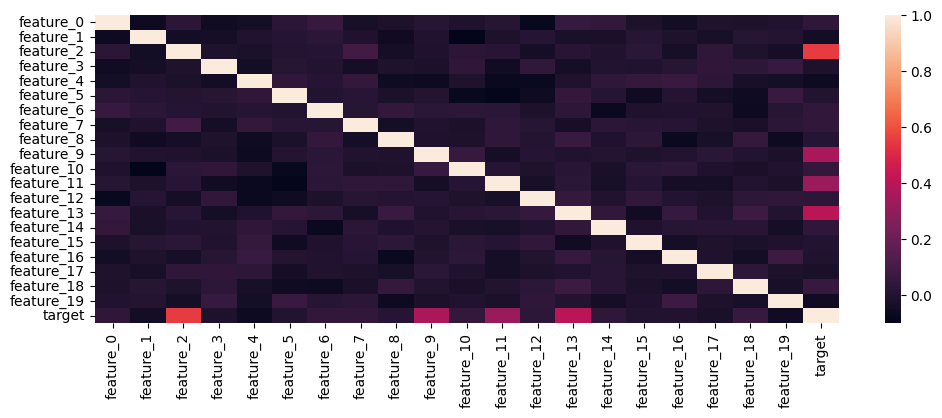

In [7]:
sns.heatmap( df.corr(), figure=plt.figure(figsize=(12, 4)) )

<Axes: >

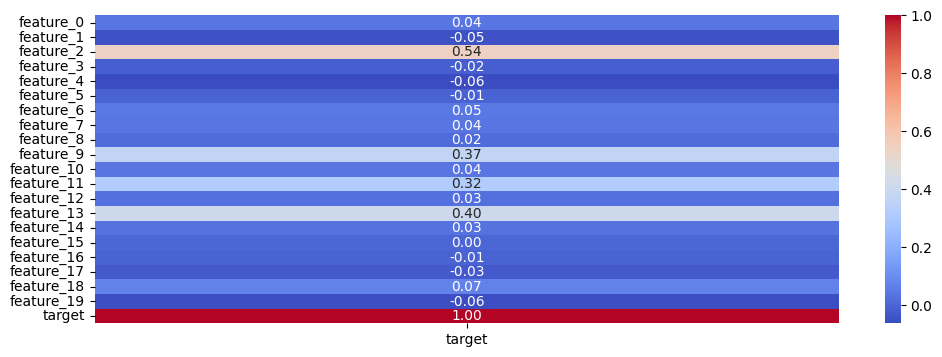

In [8]:
vals = df.corr('spearman')['target'].values # Sepearman used for quantitive data
cols = df.columns

sns.heatmap( 
    pd.DataFrame(vals, index=cols, columns=['target']), 
    annot=True, 
    cmap='coolwarm', 
    fmt='.2f', 
    figure=plt.figure(figsize=(12, 4))
)

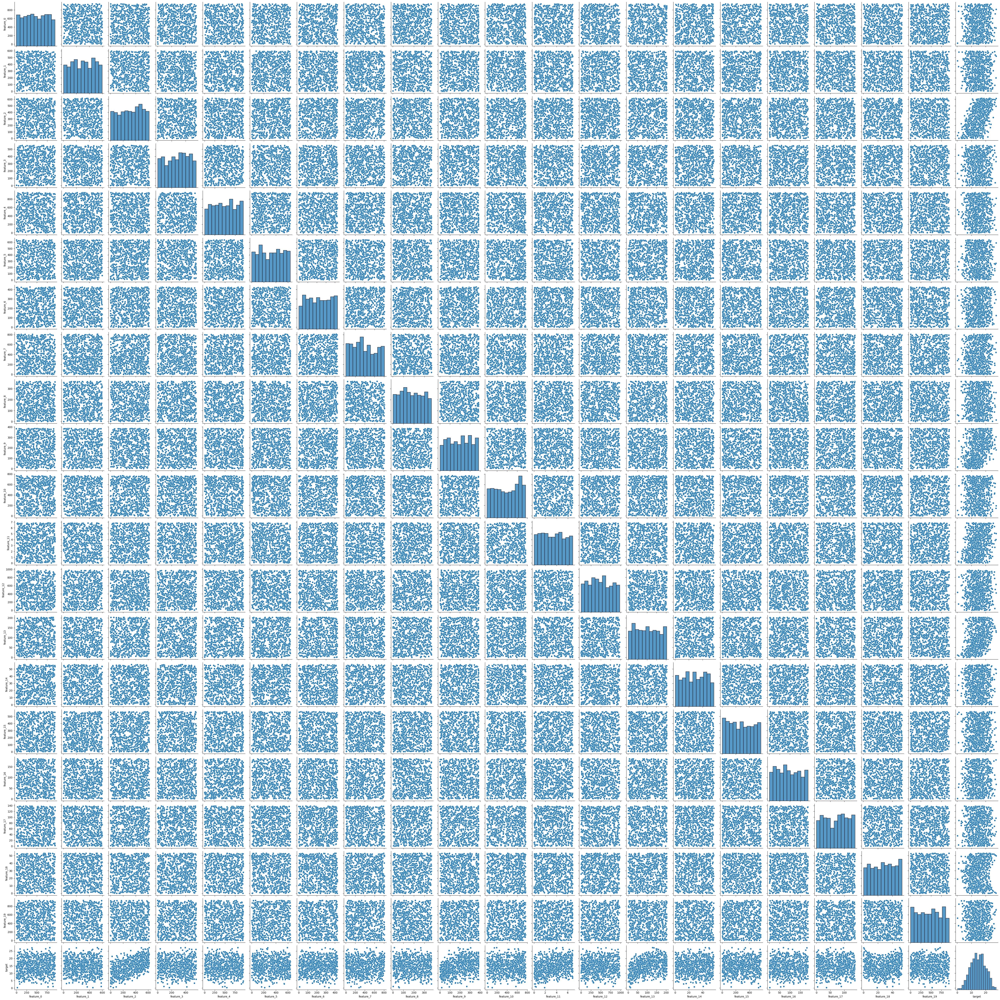

In [67]:
sns.pairplot( df )

### Insights: 
1. All values are float values, wich leads to think these are all 100% contiuos and numerical = quantitative.
2. I can appresiate at the moment that every single data point starts at the same point, but not all of them tend to be on the same ranges, and are all positive.
3. There is no missing data in the dataset, no aditional processing needed.
4. Columns are not strongly correlated, meaning there can be less probability of colinearity. We should try first normalization.
5. There is a stronger correlationship between some features, which might indicate an interesting PCA analysis
6. It looks that the only data that follows any distribution is the target value, looks pretty gausian.

### Path of action
1. Standarize data and check for colineality and distribution of datapoints (not used for random forest)
2. Do PCA and try to check for colineality and distribution of datapoints

In [37]:
normalized_df=(df-df.min())/(df.max()-df.min())

<Axes: >

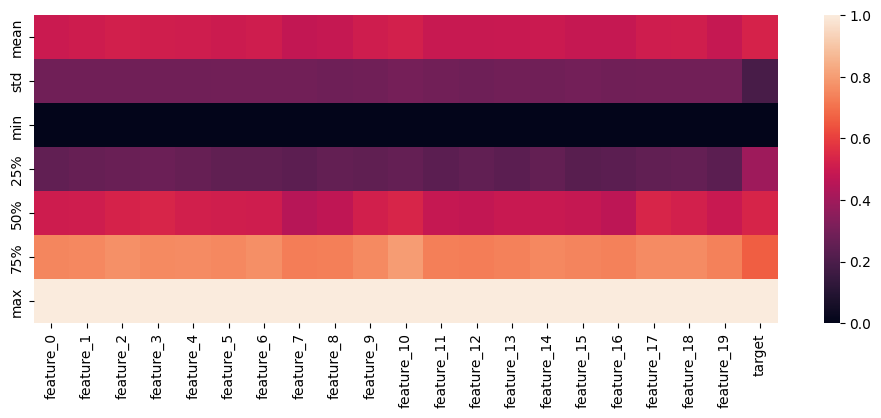

In [13]:
sns.heatmap(normalized_df.describe().drop('count'), figure=plt.figure(figsize=(12, 4)))

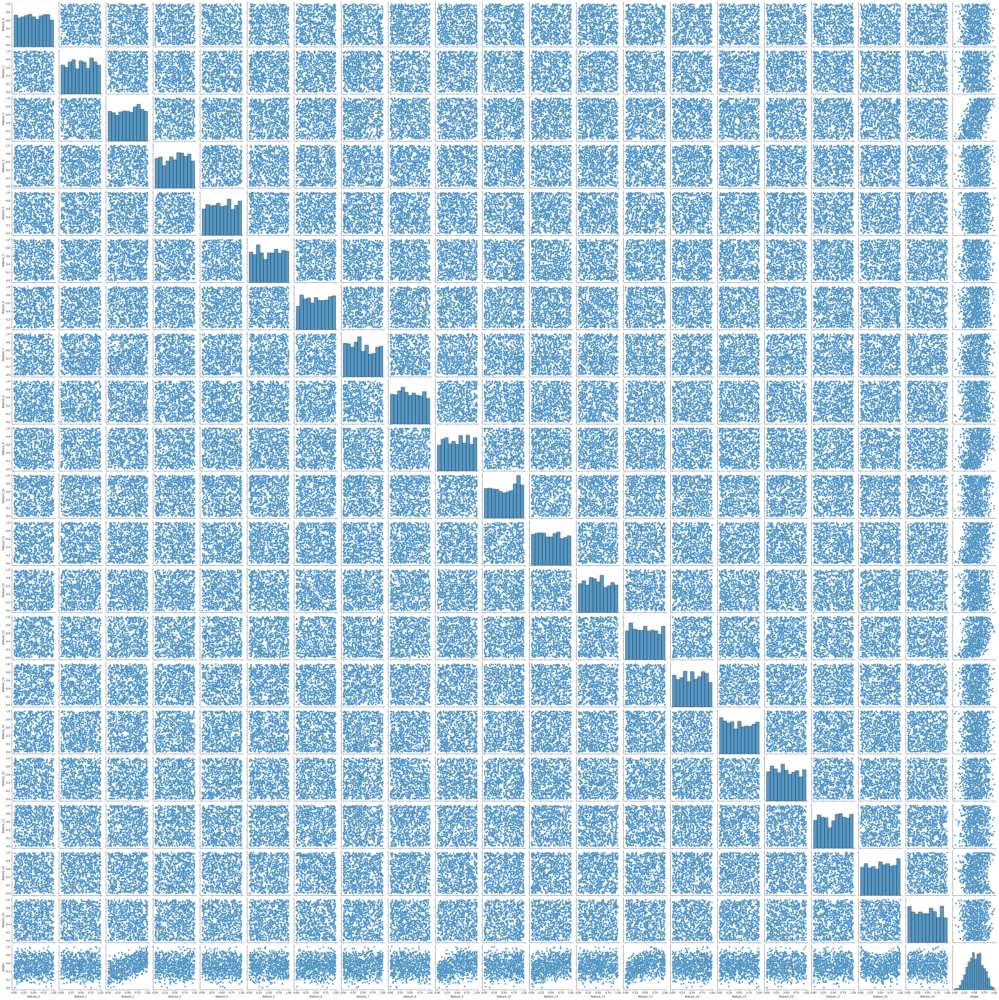

In [78]:
sns.pairplot( normalized_df )

### PCA without transformation

In [5]:
from sklearn.decomposition import PCA

min = (0,0) # (number of components, explained variance ratio)

for component in range(1, 20):
    pca = PCA(n_components=component)
    pca.fit(df.drop('target', axis=1))

    print(f"Explained variance ratio for {component} components: {pca.explained_variance_ratio_.sum()}")
    if pca.explained_variance_ratio_.sum() > min[1] and pca.explained_variance_ratio_.sum() < 0.90:
        min = (component, pca.explained_variance_ratio_.sum())

print(f"Minimum number of components to explain {min[1]} of the variance: {min[0]}")

Explained variance ratio for 1 components: 0.13946239252282622
Explained variance ratio for 2 components: 0.2701124848942791
Explained variance ratio for 3 components: 0.3912063107146504
Explained variance ratio for 4 components: 0.5008789682660922
Explained variance ratio for 5 components: 0.5933776364272475
Explained variance ratio for 6 components: 0.6823049998152203
Explained variance ratio for 7 components: 0.7384345494392515
Explained variance ratio for 8 components: 0.7897711211578939
Explained variance ratio for 9 components: 0.8372975905630687
Explained variance ratio for 10 components: 0.8823612241763501
Explained variance ratio for 11 components: 0.9226739372763013
Explained variance ratio for 12 components: 0.9481972399490833
Explained variance ratio for 13 components: 0.9685295280048332
Explained variance ratio for 14 components: 0.9860003396884474
Explained variance ratio for 15 components: 0.9918071664902406
Explained variance ratio for 16 components: 0.9964548191963376


In [6]:
pca = PCA(n_components=min[0])
pca.fit(normalized_df.drop('target', axis=1))

pca_df = pd.DataFrame(
    pca.transform(normalized_df.drop('target', axis=1)),
    columns=[f"component_{i}" for i in range(1, min[0]+1)]
)
pca_df['target'] = normalized_df['target']

<Axes: >

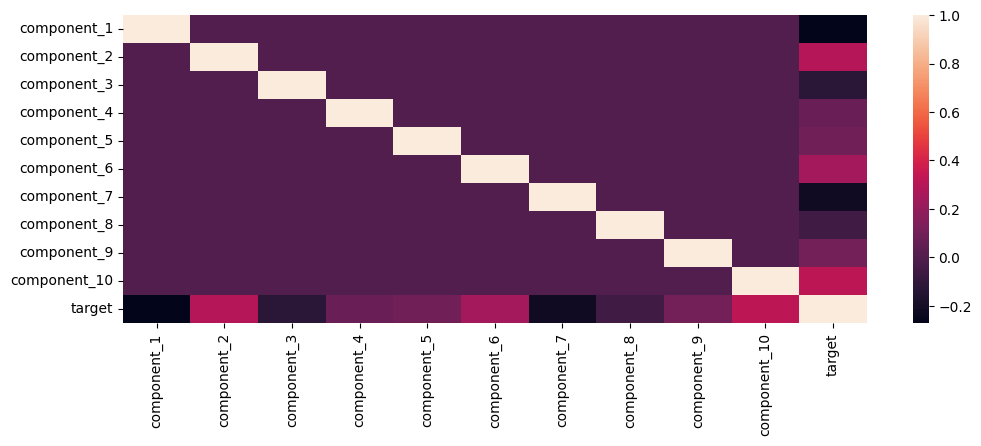

In [97]:
sns.heatmap( pca_df.corr(), figure=plt.figure(figsize=(12, 4) ) )

### PCA with standarization of the data

In [7]:
from sklearn.decomposition import PCA

min = (0,0) # (number of components, explained variance ratio)

for component in range(1, 20):
    pca = PCA(n_components=component)
    pca.fit(normalized_df.drop('target', axis=1))

    print(f"Explained variance ratio for {component} components: {pca.explained_variance_ratio_.sum()}")
    if pca.explained_variance_ratio_.sum() > min[1] and pca.explained_variance_ratio_.sum() < 0.90:
        min = (component, pca.explained_variance_ratio_.sum())

print(f"Minimum number of components to explain {min[1]} of the variance: {min[0]}")

Explained variance ratio for 1 components: 0.06427299464881543
Explained variance ratio for 2 components: 0.12505669630829233
Explained variance ratio for 3 components: 0.18548227139479176
Explained variance ratio for 4 components: 0.24547207615321257
Explained variance ratio for 5 components: 0.30342052691590765
Explained variance ratio for 6 components: 0.35808536192306406
Explained variance ratio for 7 components: 0.4118831970477745
Explained variance ratio for 8 components: 0.4639680819711075
Explained variance ratio for 9 components: 0.515576744147965
Explained variance ratio for 10 components: 0.5670214638990081
Explained variance ratio for 11 components: 0.6162543705942551
Explained variance ratio for 12 components: 0.6637506366170116
Explained variance ratio for 13 components: 0.7097935017478668
Explained variance ratio for 14 components: 0.7556513922689646
Explained variance ratio for 15 components: 0.7999334315868084
Explained variance ratio for 16 components: 0.8434621417053

In [8]:
pca = PCA(n_components=min[0])
pca.fit(normalized_df.drop('target', axis=1))

pca_df = pd.DataFrame(
    pca.transform(normalized_df.drop('target', axis=1)),
    columns=[f"component_{i}" for i in range(1, min[0]+1)]
)
pca_df['target'] = normalized_df['target']

<Axes: >

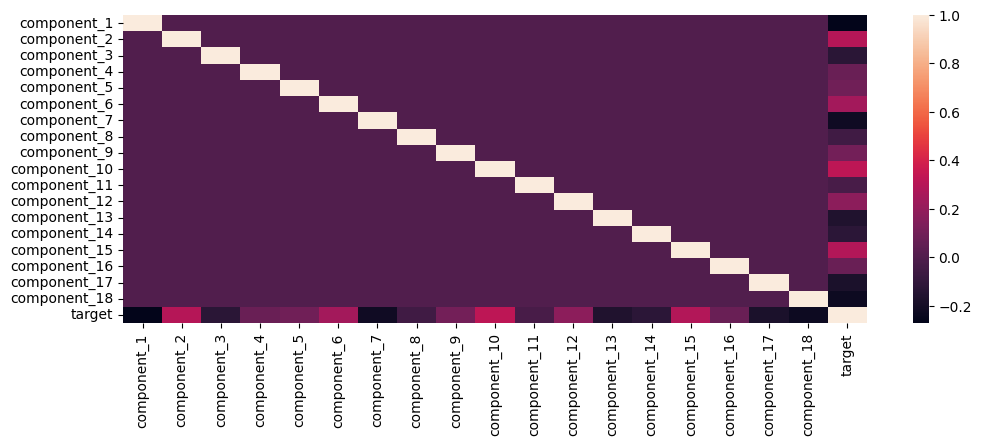

In [91]:
sns.heatmap( pca_df.corr(), figure=plt.figure(figsize=(12, 4) ) )

### Insights:

1. Standarized data tends to give worst results on PCA, we can only pack 90% of explainable data on 18 components, rather than 10 without standarizing it.

### Plan of action

0. Generate Train, Test data for each experiment: Non-Standarized/No-PCA, Standarized/No-PCA, NonStandarized/PCA, Standarized-PCA.
1. Test on 2 ML Techniques RF and Linear Regression on Experiments
2. Test on DNN 1,3,5 layers on Experiments
3. Compare results and decide on the best approach ( With/out PCA, With/out Standarization, ML/DL algorithm )

### Expectations
1. Best results at Linear Regression, No Standarization, with 10 PCA Components.
2. Second best resutls at 3 Layer DNN, Standarized, No PCA.

### First Experiment: Non-Standarized/No-PCA

In [50]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(df, test_size=0.2, random_state=42)

#### Linear Regression

In [60]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score as R2Score
LR = LinearRegression()

LR.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], LR.predict(df_test.drop('target', axis=1)))

0.6961671847695117

#### Random Forest

In [61]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score as R2Score

RF = RandomForestRegressor()
RF.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], RF.predict(df_test.drop('target', axis=1)))

0.7046672532302173

#### DNN 1, 3, 5 Layers

In [54]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score as R2Score
from tensorflow.random import set_seed
import tensorflow as tf

## Hyperparameter tunning: 1, 3, 5 layers with 10 neurons each

results = []

set_seed(42)

for i in [1,3,5]:
    model = Sequential()
    model.add(Input(shape=(df_train.drop('target', axis=1).shape[1],)))
    for ii in range(i):
        model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='linear'))

    earlySTopping = EarlyStopping(monitor='val_loss', patience=3)

    model.compile(optimizer='adam', loss='mse')
    model.fit(
        df_train.drop('target', axis=1), 
        df_train['target'], 
        epochs=300,
        batch_size=32, 
        validation_split=0.2, 
        callbacks=[earlySTopping]
    )

    results.append(
        R2Score(
            df_test['target'], 
            model.predict(df_test.drop('target', axis=1))
        )
    )

for result in results:
    print(f"r2 score: {result}")

Epoch 1/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step - loss: 59478.8242 - val_loss: 36466.4492
Epoch 2/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 34088.8398 - val_loss: 31308.1816
Epoch 3/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 27850.6035 - val_loss: 24400.8359
Epoch 4/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 22169.2246 - val_loss: 20162.9492
Epoch 5/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 18078.6797 - val_loss: 16935.6836
Epoch 6/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 15122.0615 - val_loss: 14325.5137
Epoch 7/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 12866.3916 - val_loss: 12438.7920
Epoch 8/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11169.1436 - val_loss: 10992.8018
Epoch 9/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9840.7305 - val_loss: 9831.8340
Epoch 10/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 8788.1855 - val_loss: 8875.7217
Epoch 11/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 7929.7241

### Second Experiment: Standarized-No PCA

In [62]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(normalized_df, test_size=0.2, random_state=42)

#### Linear Regression

In [63]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score as R2Score
LR = LinearRegression()

LR.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], LR.predict(df_test.drop('target', axis=1)))

0.6961671847695117

#### Random Forest

In [64]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score as R2Score

RF = RandomForestRegressor()
RF.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], RF.predict(df_test.drop('target', axis=1)))

0.7062752435048487

#### DNN 1, 3, 5 Layers

In [73]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score as R2Score
from tensorflow.random import set_seed
import tensorflow as tf

## Hyperparameter tunning: 1, 3, 5 layers with 10 neurons each

results = []

set_seed(42)

for i in [1,3,5]:
    model = Sequential()
    model.add(Input(shape=(df_train.drop('target', axis=1).shape[1],)))
    for ii in range(i):
        model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='linear'))

    earlySTopping = EarlyStopping(monitor='val_loss', patience=3)

    model.compile(optimizer='adam', loss='mse')
    model.fit(
        df_train.drop('target', axis=1), 
        df_train['target'], 
        epochs=300,
        batch_size=32, 
        validation_split=0.2, 
        callbacks=[earlySTopping]
    )

    results.append(
        R2Score(
            df_test['target'], 
            model.predict(df_test.drop('target', axis=1))
        )
    )

for result in results:
    print(f"r2 score: {result}")

Epoch 1/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 67145.8281 - val_loss: 58397.9297
Epoch 2/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 52720.5039 - val_loss: 47356.2500
Epoch 3/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 41526.1680 - val_loss: 38579.7383
Epoch 4/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 32914.7578 - val_loss: 31687.5312
Epoch 5/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 26362.4512 - val_loss: 26216.6387
Epoch 6/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 21354.0957 - val_loss: 21844.3398
Epoch 7/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 17482.5137 - val_loss: 18362.7617
Epoch 8/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 14502.5049 - val_loss: 15525.3516
Epoch 9/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 12152.9971 - val_loss: 13194.3535
Epoch 10/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 10259.6982 - val_loss: 11278.4844
Epoch 11/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 87

### Third Experiment: No-Standarize/PCA

In [65]:
from sklearn.decomposition import PCA

pca = PCA(n_components=10)
pca.fit(df.drop('target', axis=1))

pca_df = pd.DataFrame(
    pca.transform(df.drop('target', axis=1)),
    columns=[f"component_{i}" for i in range(0, 10)]
)
pca_df['target'] = df['target']

In [66]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(pca_df, test_size=0.2, random_state=42)

#### Linear Regression

In [67]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score as R2Score

LR = LinearRegression()
LR.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], LR.predict(df_test.drop('target', axis=1)))

0.1785717925870951

#### Random Forest

In [68]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score as R2Score

RF = RandomForestRegressor()
RF.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], RF.predict(df_test.drop('target', axis=1)))

0.10234604379009737

#### DNN 1, 3, 5 Layers

In [74]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score as R2Score
from tensorflow.random import set_seed
import tensorflow as tf

## Hyperparameter tunning: 1, 3, 5 layers with 10 neurons each

results = []

set_seed(42)

for i in [1,3,5]:
    model = Sequential()
    model.add(Input(shape=(df_train.drop('target', axis=1).shape[1],)))
    for ii in range(i):
        model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='linear'))

    earlySTopping = EarlyStopping(monitor='val_loss', patience=3)

    model.compile(optimizer='adam', loss='mse')
    model.fit(
        df_train.drop('target', axis=1), 
        df_train['target'], 
        epochs=300,
        batch_size=32, 
        validation_split=0.2, 
        callbacks=[earlySTopping]
    )

    results.append(
        R2Score(
            df_test['target'], 
            model.predict(df_test.drop('target', axis=1))
        )
    )

for result in results:
    print(f"r2 score: {result}")

Epoch 1/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 41444.1562 - val_loss: 33567.3633
Epoch 2/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 34010.7812 - val_loss: 27441.8223
Epoch 3/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 28028.4043 - val_loss: 22565.5625
Epoch 4/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 23216.6250 - val_loss: 18706.7812
Epoch 5/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 19379.5977 - val_loss: 15631.0000
Epoch 6/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 16288.0410 - val_loss: 13141.3818
Epoch 7/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 13759.5498 - val_loss: 11112.6523
Epoch 8/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 11681.3877 - val_loss: 9452.3008
Epoch 9/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 9959.1133 - val_loss: 8073.2617
Epoch 10/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 8531.3818 - val_loss: 6939.6084
Epoch 11/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7348.0483 - v

### Fourth Experiment: Standarized/PCA

In [72]:
pca = PCA(n_components=17)
pca.fit(normalized_df.drop('target', axis=1))

pca_df = pd.DataFrame(
    pca.transform(normalized_df.drop('target', axis=1)),
    columns=[f"component_{i}" for i in range(0, 17)]
)
pca_df['target'] = normalized_df['target']

In [69]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(pca_df, test_size=0.2, random_state=42)

#### Linear Regression

In [71]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score as R2Score

LR = LinearRegression()
LR.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], LR.predict(df_test.drop('target', axis=1)))

0.1785717925870951

#### Random Forest

In [72]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score as R2Score

RF = RandomForestRegressor()
RF.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], RF.predict(df_test.drop('target', axis=1)))

0.0973284701853816

#### DNN 1, 3, 5 Layers

In [75]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score as R2Score
from tensorflow.random import set_seed
import tensorflow as tf

## Hyperparameter tunning: 1, 3, 5 layers with 10 neurons each

results = []

set_seed(42)

for i in [1,3,5]:
    model = Sequential()
    model.add(Input(shape=(df_train.drop('target', axis=1).shape[1],)))
    for ii in range(i):
        model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='linear'))

    earlySTopping = EarlyStopping(monitor='val_loss', patience=3)

    model.compile(optimizer='adam', loss='mse')
    model.fit(
        df_train.drop('target', axis=1), 
        df_train['target'], 
        epochs=300,
        batch_size=32, 
        validation_split=0.2, 
        callbacks=[earlySTopping]
    )

    results.append(
        R2Score(
            df_test['target'], 
            model.predict(df_test.drop('target', axis=1))
        )
    )

for result in results:
    print(f"r2 score: {result}")

Epoch 1/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 19747.4160 - val_loss: 22931.9590
Epoch 2/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 16079.3818 - val_loss: 19309.1309
Epoch 3/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 13305.0029 - val_loss: 16338.4688
Epoch 4/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 11119.3301 - val_loss: 13934.9209
Epoch 5/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 9375.8848 - val_loss: 11960.8359
Epoch 6/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 7970.9053 - val_loss: 10314.5342
Epoch 7/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 6846.8169 - val_loss: 8909.9160
Epoch 8/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5931.1128 - val_loss: 7726.4819
Epoch 9/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 5175.5771 - val_loss: 6724.6968
Epoch 10/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4545.3691 - val_loss: 5879.9644
Epoch 11/300
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 4018.0776 - val_lo

#### Results:
We have a 70.6% R^2 with Random Forest by standarizing the data. This is counter intuitive, but after finalizing the analysis, we figured out which technique to use.

In [76]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(normalized_df, test_size=0.2, random_state=42)

In [77]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score as R2Score

RF = RandomForestRegressor()
RF.fit(df_train.drop('target', axis=1), df_train['target'])
R2Score(df_test['target'], RF.predict(df_test.drop('target', axis=1)))

0.7125617921078184

In [78]:
import joblib

joblib.dump(RF, '../model.pkl')

['../model.pkl']

## 2. File
File blind_test_data.csv contains 200 samples with the same 20 features as
above; you must propose a solution that allows a user to predict the missing target value for
these samples using the model you created using the training data. Make a special effort to
develop or propose a solution that allows these bulk operations to be carried out regularly.


## Deliveries
1. Train a model using the training data set.
2. Create a project that can be deployed easily. The PoC needs to use the model you
created to provide new predictions, (use the provided blind test dataset to test your
solution).
3. Describe briefly how you can evolve the solution..

In [79]:
%%writefile ../main.py

import pandas as pd
import joblib
from sklearn.metrics import r2_score as R2Score
from tensorflow.random import set_seed

set_seed(42) # Set seed for reproducibility

# This needs to be changed with a method that pulls data from a source (Bucket, DB, DWH, etc)
# Using a static name, can make the pulled content dynamic and always output different predictions.
df = pd.read_csv("./datasets/blind_test_data.csv")

# This needs to be changed with a method that loads the model from a source (Repo, Bucket, linrary, etc)
# models should not be hardcoded, but loaded dynamically when available
model = joblib.load("./model.pkl")

df_original = pd.read_csv('./datasets/training_data.csv') # This is used to scale data back to original values
df_original_no_target = df_original.drop('target', axis=1)

if __name__ == '__main__':
    normalized_df=(df-df_original_no_target.min())/(df_original_no_target.max()-df_original_no_target.min())
    prediction = model.predict(normalized_df)
    normalized_df['target_pred'] = prediction
    denormalized_df = normalized_df * ( df_original.max() - df_original.min() ) + df_original.min()
    print(denormalized_df['target_pred'])
    # This needs to be changed with a method that pushes data to a destination (Bucket, DB, DWH, etc)
    # Here we can also add monitoring of the model, like logging the prediction, the model used, the time it took to make the prediction, etc.
    denormalized_df.to_csv("./datasets/prediction.csv", index=False)

Overwriting ../main.py


In [37]:
%%writefile Dockerfile
from python:3.8

COPY . /app
WORKDIR /app

RUN pip install -r requirements.txt

CMD ["python", "main.py"]

Writing Dockerfile


### Another way to do it (non enterprise level)

In [80]:
%%writefile ../streamlit_app.py

import pandas as pd
import joblib
from sklearn.metrics import r2_score as R2Score
import streamlit as st

@st.cache_resource
def get_model():
    # This needs to be changed with a method that loads the model from a source (Repo, Bucket, linrary, etc)
    # models should not be hardcoded, but loaded dynamically when available
    return joblib.load("./model.pkl")

st.title('Prediction POC - Christopher Orea')
uploaded_file = st.file_uploader("Upload a CSV file. 200 Mbs Max.", type=["csv"])

df_original = pd.read_csv('./datasets/training_data.csv') # This is used to scale data back to original values
df_original_no_target = df_original.drop('target', axis=1)

if uploaded_file is not None:
    model = get_model()

    df = pd.read_csv(uploaded_file)
    normalized_df=(df-df_original_no_target.min())/(df_original_no_target.max()-df_original_no_target.min())
    prediction = model.predict(normalized_df)
    normalized_df['target_pred'] = prediction
    denormalized_df = normalized_df * ( df_original.max() - df_original.min() ) + df_original.min()
    st.write(denormalized_df)

st.markdown(f"[Let's start working together](https://www.linkedin.com/in/chrisgalleta/)") 

Overwriting ../streamlit_app.py


This code is executed [here](https://christopherorea-wizeline-challenge-streamlit-app-cmil8x.streamlit.app/)

### How to evolve the project?

1. I would require to robust the solution: Cybersecutiry is important, creating a pipeline to pull and push data from and to defined sources (databases, DWHs, Buckets) and having governance on how to access it without compromising the integrity of data is vital. A method that allows to pull using secret manager from cloud would be effective.

2. I would monitor the output of the model: A function that allows the team to understand performance of the model with new data is vital to have a model that delivers exactly what is needed for the business.

3. I would also include a service to change the model: If the model is performing -10% below expected (R^2 -0.86), then I would use an event trigger that would start a new trainning for a new model. This can also be automated by making the same experiments and taking the model that performs the best out of them, even non supervised trainnig on PCA can be tested on how many components can be used. Maybe next time it can be done in less components or more and perform better.

4. I would also implement hyperparameter tunning techniques: Using random forest leads to a interesting implementation of XGBoost to increase model performance. We can try with different sizes of trees, depths, etc.